In [1]:
%load_ext autoreload
%autoreload 1

In [2]:
%aimport p2v
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
model = p2v.P2V()

2023-09-09 13:42:33 -- start loading Mag_venue_info_df
2023-09-09 13:42:33 -- finish.
2023-09-09 13:42:33 -- start loading labeled_journal_info_df
2023-09-09 13:42:33 -- finish.


In [16]:
start_year, end_year, d, w = 1950, 1959, 100, 10

2023-09-09 13:53:57 -- start loading word vectors...
2023-09-09 13:53:57 -- word vectors loaded, and its shape is: (1645, 100)
2023-09-09 13:53:57 -- start loading VID_labeled...
2023-09-09 13:53:57 -- finish.


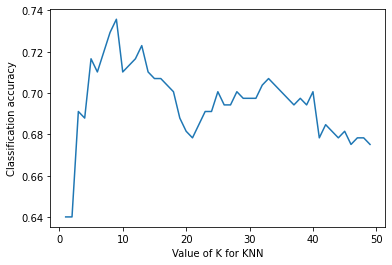

2023-09-09 13:53:57 -- the best k is: 8


In [17]:
k = model.find_k(start_year, end_year, d, w)

In [199]:
model.cal_entropy(1950, 1959, 100, 10, k=8)

2023-08-23 20:18:05 -- start loading word vectors...
2023-08-23 20:18:05 -- word vectors loaded, and its shape is: (1683, 100)
2023-08-23 20:18:05 -- start loading VID_labeled...
2023-08-23 20:18:05 -- finish.


2023-08-23 19:33:51 -- start loading wv_2d...
2023-08-23 19:33:51 -- finish.


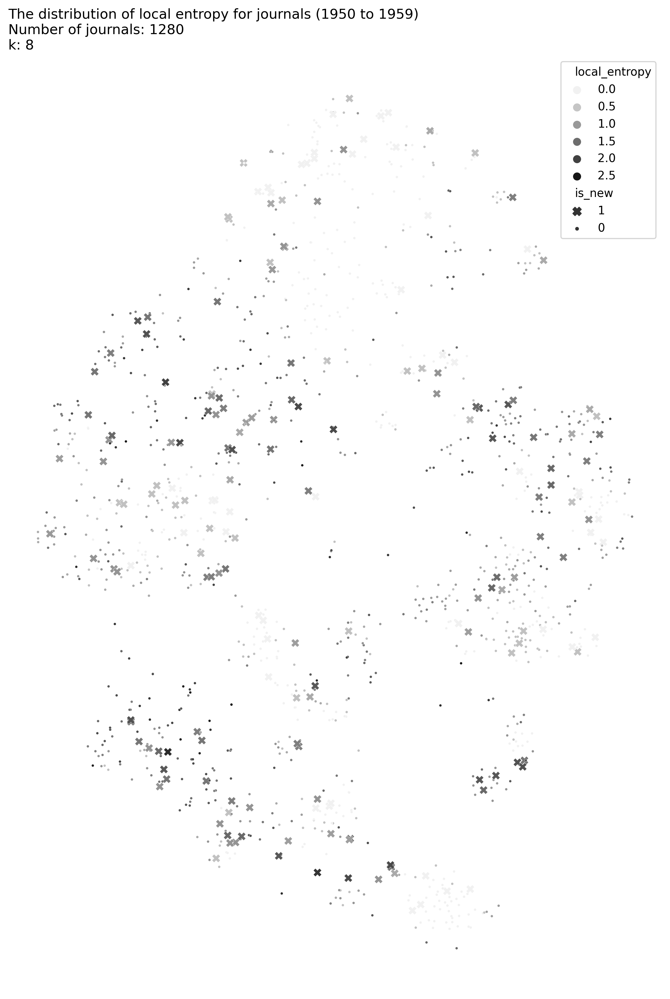

In [141]:
model.plot_local_entropy_map(1950,1959, 100, 10, k=8, 
                             y_flip=True, rotate_180=True)

Text(0, 0.5, 'frequency')

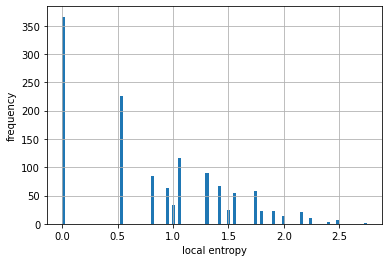

In [200]:
hist = model.knn_df.local_entropy.hist(bins=100)
hist.set_xlabel("local entropy")
hist.set_ylabel("frequency")

In [201]:
model.knn_df.sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
178,24940445,"[-0.11052856, 0.027087675, -0.024388174, 0.085...",Environmental Science,2.750000,Journal American Water Works Association,None,0
109,136658373,"[-0.2305861, 0.12601328, -0.101375654, 0.08398...",Engineering,2.500000,Industrial & Engineering Chemistry,None,0
830,163506364,"[-0.15366712, 0.084341004, -0.08250067, 0.0659...",Chemical Engineering,2.500000,Chemical & Engineering News,1923,0
253,54363390,"[-0.011865826, 0.124209575, -0.16249429, 0.056...",Engineering,2.500000,Journal of The Textile Institute Transactions,None,0
1578,82954977,"[-0.17768785, 0.10385198, -0.033343267, -0.091...",Chemistry,2.500000,Bulletin des Sociétés Chimiques Belges,1904,0
1205,12492028,"[-0.06342872, 0.08275055, -0.04996642, -0.0760...",Arts and Humanities,2.500000,Studies in Conservation,None,0
528,112095004,"[-0.041024443, 0.0027669428, -0.113261364, 0.1...",Engineering,2.500000,Journal of Chemical Technology & Biotechnology,None,0
748,91238560,"[-0.04063202, 0.16700831, -0.18761066, 0.07273...",Chemistry,2.405639,Australian Journal of Chemistry,1948,0
410,105208853,"[-0.110960916, 0.06527086, 0.008400338, 0.2134...",Chemistry,2.405639,Journal of Chemical Education,1924,0
220,153578117,"[-0.0083457315, 0.25111255, 0.058193147, 0.099...",Materials Science,2.405639,Journal of The Society of Dyers and Colourists,None,0


In [115]:
model.knn_df[model.knn_df.is_new==1].sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
1233,198339081,"[-0.13194002, 0.062454432, -0.08831825, 0.0952...",Chemical Engineering,2.250000,Electrochimica Acta,1959,1
542,22862804,"[-0.102481194, 0.024084697, -0.0970829, 0.0708...",Physics and Astronomy,2.155639,Physics of Fluids,1958,1
475,170967050,"[0.09207086, -0.025122497, -0.16080326, 0.0539...",Medicine,2.000000,American Journal of Epidemiology,1965,1
1101,103482838,"[-0.09987308, 0.13201979, -0.13779387, -0.1035...",Computer Science,1.905639,Communications of The ACM,1959,1
1136,165592611,"[0.073617965, 0.025329787, 0.2519424, -0.10517...",Neuroscience,1.905639,Experimental Neurology,1959,1
434,73111969,"[0.0033918887, -0.0022893338, -0.09085993, 0.0...",Immunology and Microbiology,1.905639,Journal of Eukaryotic Microbiology,1993,1
420,152000018,"[-0.14235525, 0.07158207, -0.06308996, -0.0929...",Engineering,1.905639,Journal of Fluid Mechanics,1956,1
426,71285955,"[-0.0070108227, 0.004200566, 0.10399215, 0.224...",Nursing,1.905639,The American Journal of Clinical Nutrition,1952,1
676,133942674,"[-0.15412806, 0.109970994, -0.06097293, 0.1067...","Biochemistry, Genetics and Molecular Biology",1.811278,Tetrahedron Letters,1959,1
1096,55776271,"[0.10131159, 0.038442, -0.058255903, 0.0098848...",Immunology and Microbiology,1.811278,Viruses,2009,1


In [142]:
center_VID = 198339081

In [143]:
neighbor_index = model.knn.kneighbors(X=model.knn_df[model.knn_df.VID==center_VID].vector.to_list(), n_neighbors=8, return_distance=False)
neighbor_df = model.knn_df.iloc[neighbor_index.reshape(-1,)]
neighbor_df = neighbor_df.drop(neighbor_df[neighbor_df.VID==center_VID].index)

In [144]:
neighbor_df[['VID', 'venue_name', 'year_founded', 'is_new', 'label']]

,VID,venue_name,year_founded,is_new,label
1391,143604795,Journal of Electroanalytical Chemistry,1959,1,Chemistry
679,56956632,Transactions of The Institute of Metal Finishing,None,0,Physics and Astronomy
934,168357330,Tetsu To Hagane-journal of The Iron and Steel ...,None,0,Physics and Astronomy
1021,78451586,Journal of The Less Common Metals,None,0,Engineering
1503,2764701539,CORROSION ENGINEERING DIGEST,None,0,Engineering
1645,91306253,Anti-corrosion Methods and Materials,None,0,Chemical Engineering
1148,149516416,Journal of Nuclear Materials,1959,1,Materials Science


2023-08-23 19:35:24 -- start loading VID_labeled...
2023-08-23 19:35:24 -- finish.
2023-08-23 19:35:24 -- start loading wv_2d...
2023-08-23 19:35:24 -- finish.


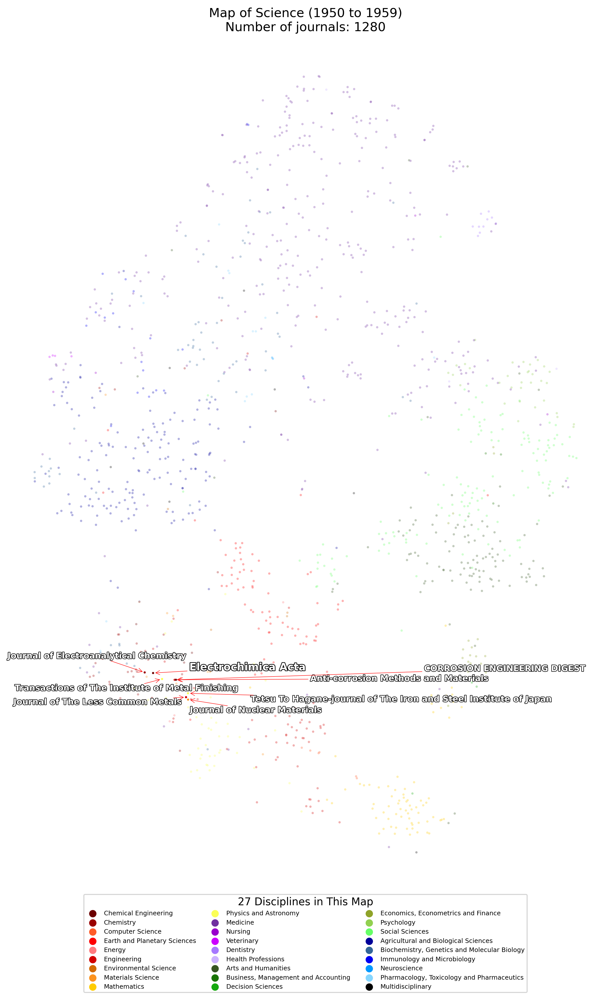

In [146]:
model.plot_map_of_sci(1950,1959, 100, 10,
                      y_flip=True, rotate_180=True,
                      annotate=True, center_VID=center_VID, neighbor_VID_list=neighbor_df.VID.to_list())

In [196]:
model.cal_entropy(1960, 1969, 100, 10, k=4)

2023-08-23 20:16:02 -- start loading word vectors...
2023-08-23 20:16:02 -- word vectors loaded, and its shape is: (3186, 100)
2023-08-23 20:16:02 -- start loading VID_labeled...
2023-08-23 20:16:02 -- finish.


2023-08-23 19:36:04 -- start loading wv_2d...
2023-08-23 19:36:04 -- finish.


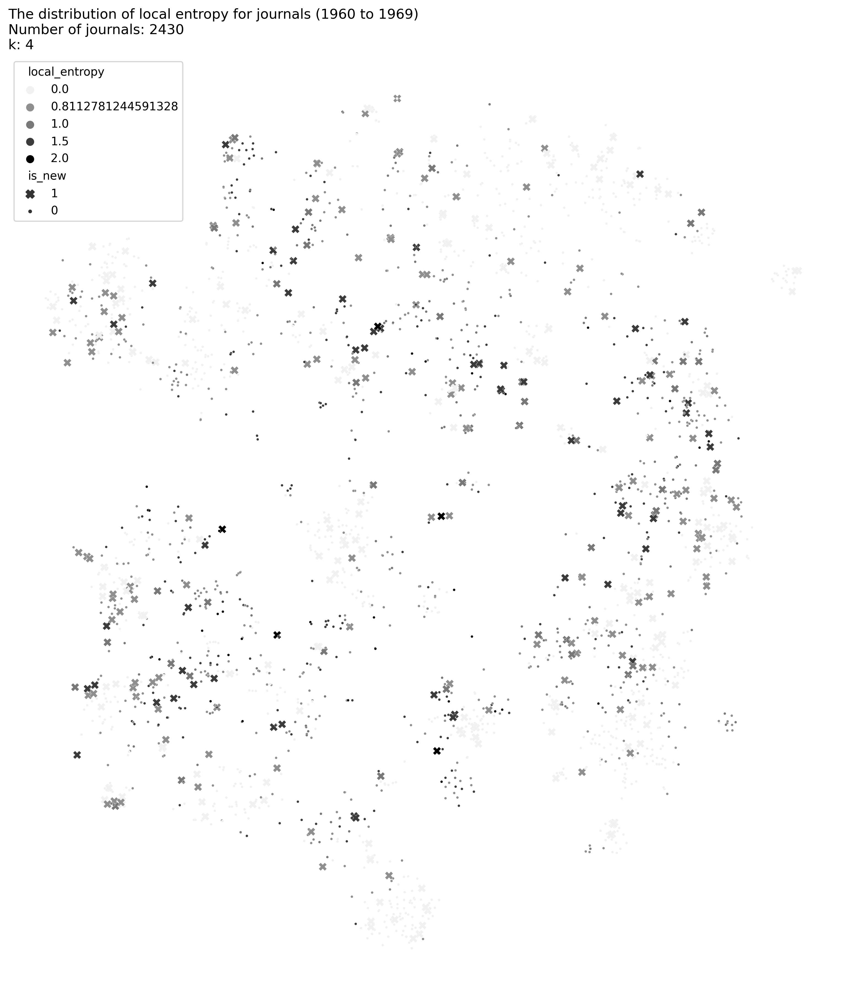

In [148]:
model.plot_local_entropy_map(1960,1969, 100, 10, k=4)

Text(0, 0.5, 'frequency')

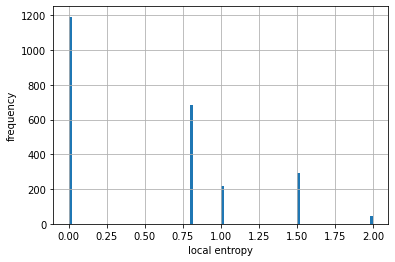

In [197]:
hist = model.knn_df.local_entropy.hist(bins=100)
hist.set_xlabel("local entropy")
hist.set_ylabel("frequency")

In [198]:
model.knn_df.sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
1665,59886954,"[0.04024625, -0.059679348, -0.10204367, -0.077...",Chemical Engineering,2.0,Chemical and Petroleum Engineering,None,0
1186,40303635,"[-0.15665506, 0.05929361, -0.155271, 0.0182124...",Medicine,2.0,Journal of Radiation Research,1960,1
1196,32106766,"[0.052457076, -0.036599714, 0.0677298, -0.0397...",Engineering,2.0,Journal of Rheology,1929,0
166,135837084,"[0.13790704, 0.09916098, 0.001683557, 0.032085...","Biochemistry, Genetics and Molecular Biology",2.0,Journal of Neurochemistry,1956,0
922,5745031,"[-0.0018757095, 0.065199, -0.019265356, -0.239...",Materials Science,2.0,Solar Energy,1957,0
2253,54259846,"[0.029722372, -0.004921575, -0.18867688, -0.01...",Medicine,2.0,Acta Crystallographica Section B Structural Cr...,None,0
2039,95881276,"[0.027247448, 0.08600332, -0.2288983, 0.020069...",Physics and Astronomy,2.0,Radioisotopes,None,0
42,121340927,"[-0.0107432995, 0.036531482, -0.1656749, -0.08...",Medicine,2.0,Journal of Comparative and Physiological Psych...,1921,0
2857,155723790,"[0.06803611, 0.044703037, -0.10041006, -0.0318...","Pharmacology, Toxicology and Pharmaceutics",2.0,Medicinal Chemistry,None,0
1927,13479253,"[-0.04428526, 0.0049143094, -0.08898052, -0.03...",Chemistry,2.0,Environmental Science & Technology,1967,1


In [109]:
model.knn_df[model.knn_df.is_new==1].sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
2630,141109035,"[-0.08102931, -0.045061722, 0.19943142, -0.008...",Materials Science,2.0,Micron,1969,1
1186,40303635,"[-0.15665506, 0.05929361, -0.155271, 0.0182124...",Medicine,2.0,Journal of Radiation Research,1960,1
1878,93646482,"[-0.09853017, 0.03552395, -0.05520601, -0.1496...",Materials Science,2.0,Fire Technology,1965,1
1927,13479253,"[-0.04428526, 0.0049143094, -0.08898052, -0.03...",Chemistry,2.0,Environmental Science & Technology,1967,1
1929,130252234,"[-0.010271603, 0.056119747, 0.13133691, -0.133...",Social Sciences,2.0,Transportation Science,1967,1
1486,168717511,"[-0.106270656, 0.040259775, -0.026239367, -0.0...",Psychology,1.5,The Journal of Applied Behavioral Science,1965,1
1954,194044894,"[-0.029806841, -0.10097826, 0.09668607, -0.100...",Mathematics,1.5,International Journal of Theoretical Physics,1968,1
916,104375418,"[-0.038509402, 0.039990835, 0.17981255, -0.062...",Medicine,1.5,Diabetologia,1965,1
1718,119146558,"[0.02288665, -0.018708222, -0.11410275, 0.0246...",Neuroscience,1.5,Developmental Psychobiology,1968,1
831,45281609,"[0.028343769, 0.046212, 0.013575377, 0.0025933...",Neuroscience,1.5,Experimental Brain Research,1966,1


In [110]:
center_VID = 40303635

In [111]:
neighbor_index = model.knn.kneighbors(X=model.knn_df[model.knn_df.VID==center_VID].vector.to_list(), n_neighbors=4, return_distance=False)
neighbor_df = model.knn_df.iloc[neighbor_index.reshape(-1,)]
neighbor_df = neighbor_df.drop(neighbor_df[neighbor_df.VID==center_VID].index)

In [112]:
neighbor_df[['VID', 'venue_name', 'year_founded', 'is_new', 'label']]

,VID,venue_name,year_founded,is_new,label
2039,95881276,Radioisotopes,None,0,Physics and Astronomy
1793,99792956,Papers in Meteorology and Geophysics,None,0,Earth and Planetary Sciences
735,134916330,The Japanese Journal of Genetics,None,0,"Biochemistry, Genetics and Molecular Biology"


2023-08-22 20:14:07 -- start loading VID_labeled...
2023-08-22 20:14:07 -- finish.
2023-08-22 20:14:07 -- start loading wv_2d...
2023-08-22 20:14:07 -- finish.


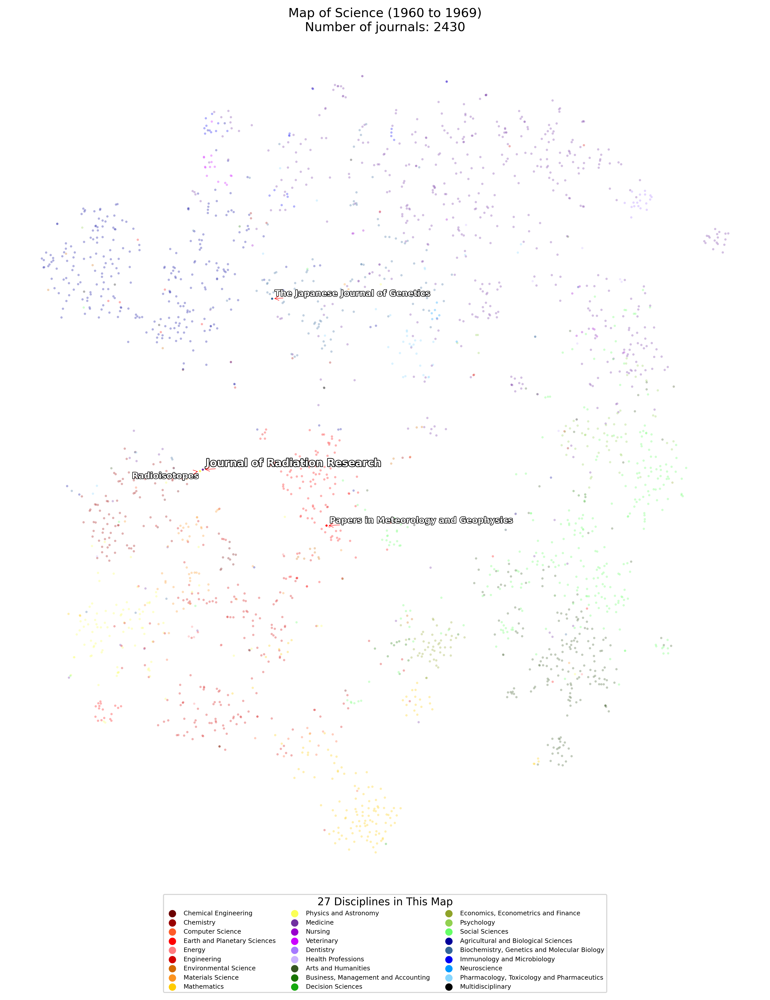

In [113]:
model.plot_map_of_sci(1960,1969, 100, 10,
                      annotate=True, center_VID=center_VID, neighbor_VID_list=neighbor_df.VID.to_list())

In [193]:
model.cal_entropy(1970, 1979, 100, 10, k=17)

2023-08-23 20:13:43 -- start loading word vectors...
2023-08-23 20:13:43 -- word vectors loaded, and its shape is: (5761, 100)
2023-08-23 20:13:43 -- start loading VID_labeled...
2023-08-23 20:13:43 -- finish.


2023-08-23 19:37:14 -- start loading wv_2d...
2023-08-23 19:37:14 -- finish.


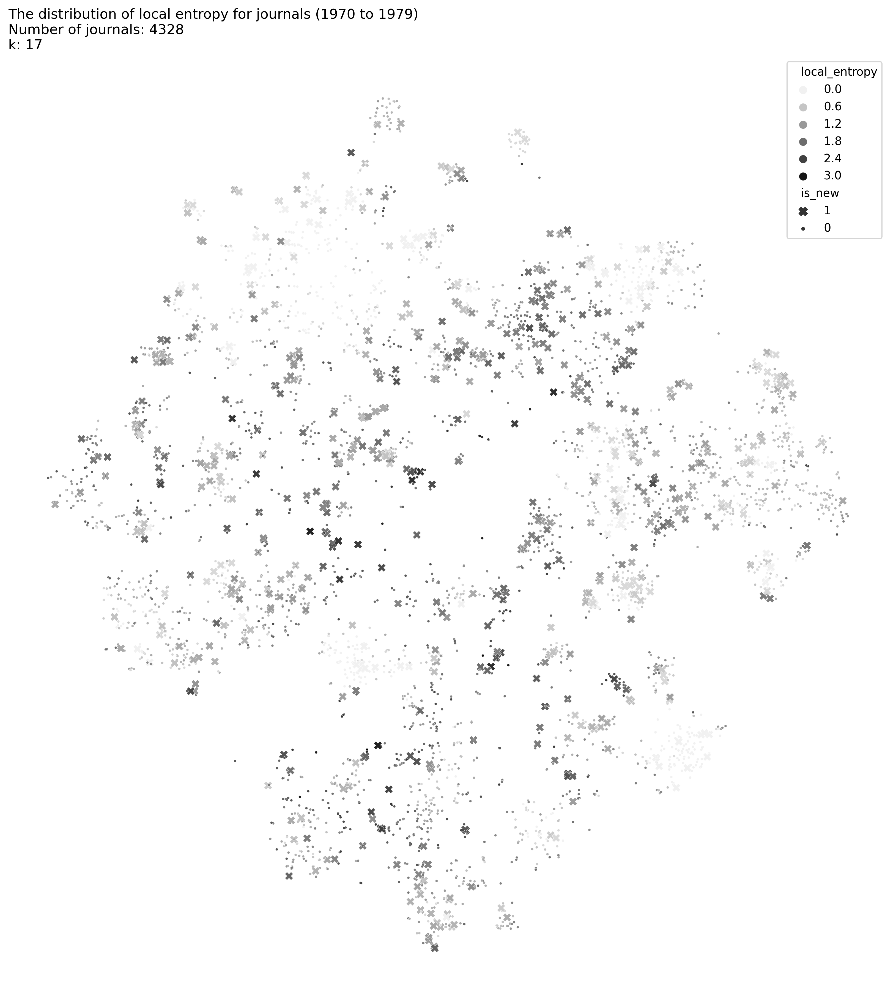

In [150]:
model.plot_local_entropy_map(1970,1979, 100, 10, k=17,
                            y_flip=True)

Text(0, 0.5, 'frequency')

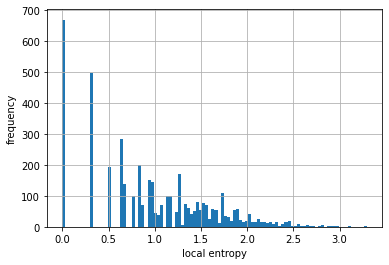

In [194]:
hist = model.knn_df.local_entropy.hist(bins=100)
hist.set_xlabel("local entropy")
hist.set_ylabel("frequency")

In [195]:
model.knn_df.sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
4361,60203362,"[-0.0147077255, -0.03389075, -0.08253026, 0.02...",Medicine,3.292770,Journal of Occupational Accidents,None,0
440,100460328,"[-0.03777111, -0.04575586, 0.004087925, 0.0550...",Multidisciplinary,3.101881,Scientific American,1845,0
3447,46351253,"[-0.017011248, -0.087884635, -0.2962102, -0.12...","Pharmacology, Toxicology and Pharmaceutics",2.984234,Journal of Biochemical Toxicology,None,0
3605,132611805,"[-0.09422743, 0.0027080304, -0.15718323, 0.018...",Chemistry,2.939829,Tenside Surfactants Detergents,None,0
3663,147202451,"[-0.10688677, -0.04290497, -0.13957442, -0.130...",Environmental Science,2.910992,Conservation & Recycling,None,0
5383,112095004,"[-0.046116985, 0.020948904, -0.12405262, 0.004...",Engineering,2.889549,Journal of Chemical Technology & Biotechnology,None,0
3804,164128033,"[-0.05086785, -0.0035512338, 0.11104757, 0.061...",Engineering,2.866587,Science News,None,0
2449,103486911,"[-0.2031904, -0.078598514, -0.04262119, -0.012...",Agricultural and Biological Sciences,2.822182,Journal of AOAC International,1992,1
1911,94432539,"[0.034069393, 0.049503043, -0.13133024, -0.048...",Health Professions,2.822182,Applied Ergonomics,None,0
3574,181849574,"[0.10691358, -0.16874996, -0.085436754, 0.0422...",Chemical Engineering,2.822182,"Propellants, Explosives, Pyrotechnics",1976,1


In [103]:
model.knn_df[model.knn_df.is_new==1].sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
2449,103486911,"[-0.2031904, -0.078598514, -0.04262119, -0.012...",Agricultural and Biological Sciences,2.822182,Journal of AOAC International,1992,1
3574,181849574,"[0.10691358, -0.16874996, -0.085436754, 0.0422...",Chemical Engineering,2.822182,"Propellants, Explosives, Pyrotechnics",1976,1
2480,173589923,"[0.06281992, -0.01925537, 0.06561568, 0.006693...",Social Sciences,2.660130,Family and Consumer Sciences Research Journal,1972,1
1070,2945435,"[0.114750095, 0.09311895, 0.09746383, 0.004124...",Neuroscience,2.654255,Animal Learning & Behavior,1973,1
2866,48860480,"[0.05585054, -0.061403234, -0.036708634, -0.00...",Energy,2.654255,International Journal of Hydrogen Energy,1976,1
2660,45897893,"[0.1300039, -0.06635757, 0.14779118, -0.036672...",Psychology,2.631293,Aggressive Behavior,1974,1
3921,51527640,"[0.027856397, -0.2323659, -0.011199908, -0.086...",Physics and Astronomy,2.581013,Scanning,1994,1
3437,143381477,"[-0.08783375, -0.10291429, 0.17871442, -0.0111...",Environmental Science,2.542483,Environment International,1978,1
865,150548798,"[-0.13127242, 0.014700375, -0.038923092, -0.05...",Earth and Planetary Sciences,2.469241,Journal of Aerosol Science,1970,1
1776,27731274,"[0.1830089, -0.10785651, 0.20036237, -0.065186...",Materials Science,2.460905,Ultramicroscopy,1975,1


In [152]:
center_VID = 181849574

In [153]:
neighbor_index = model.knn.kneighbors(X=model.knn_df[model.knn_df.VID==center_VID].vector.to_list(), n_neighbors=17, return_distance=False)
neighbor_df = model.knn_df.iloc[neighbor_index.reshape(-1,)]
neighbor_df = neighbor_df.drop(neighbor_df[neighbor_df.VID==center_VID].index)

In [154]:
neighbor_df[['VID', 'venue_name', 'year_founded', 'is_new', 'label']]

,VID,venue_name,year_founded,is_new,label
523,32869529,Combustion and Flame,1957,0,Physics and Astronomy
848,62676688,Combustion Science and Technology,None,0,Physics and Astronomy
4622,160215590,Fire Safety Journal,1977,1,Chemistry
91,53336109,AIAA Journal,1963,0,Engineering
4668,145089992,Journal of Hazardous Materials,None,0,Environmental Science
5214,40322869,International Journal of Heat and Fluid Flow,None,0,Engineering
3524,65236890,Progress in Energy and Combustion Science,None,0,Energy
4361,60203362,Journal of Occupational Accidents,None,0,Medicine
857,58867329,Journal of Thermal Analysis and Calorimetry,1969,0,Chemistry
4280,140027543,Journal of Building Physics,1977,1,Materials Science


2023-08-23 19:37:57 -- start loading VID_labeled...
2023-08-23 19:37:57 -- finish.
2023-08-23 19:37:57 -- start loading wv_2d...
2023-08-23 19:37:57 -- finish.


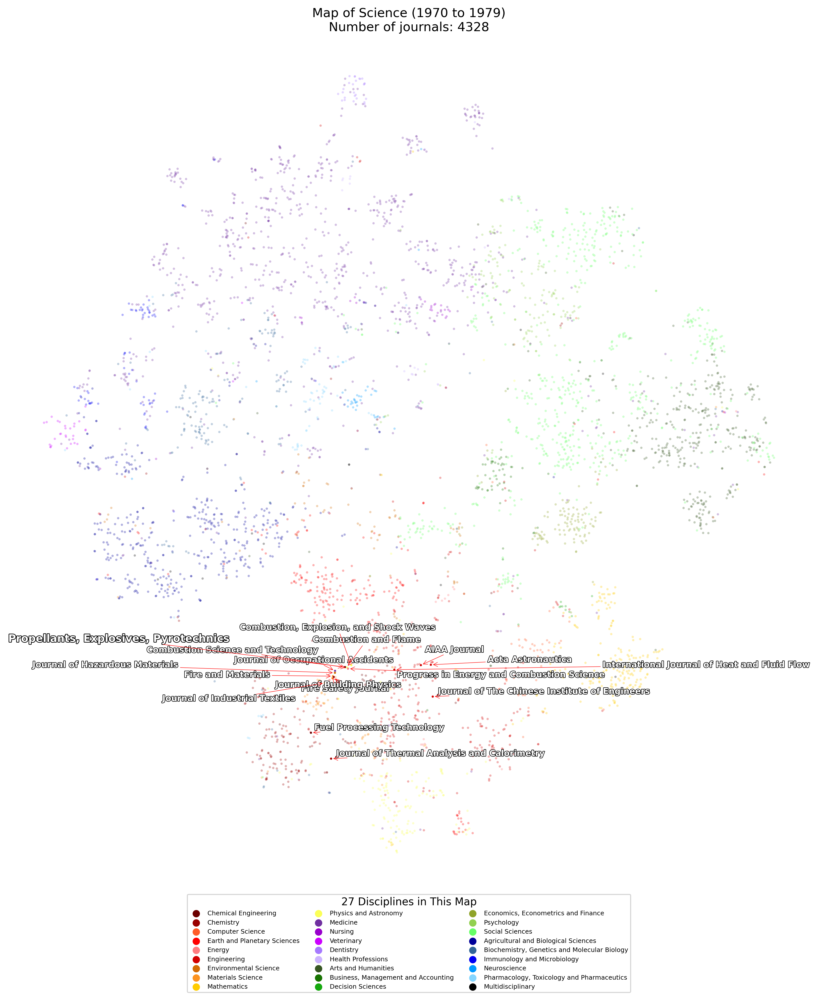

In [155]:
model.plot_map_of_sci(1970,1979, 100, 10,
                      y_flip=True,
                      annotate=True, center_VID=center_VID, neighbor_VID_list=neighbor_df.VID.to_list())

In [190]:
model.cal_entropy(1980, 1989, 100, 10, k=16)

2023-08-23 20:11:51 -- start loading word vectors...
2023-08-23 20:11:51 -- word vectors loaded, and its shape is: (9437, 100)
2023-08-23 20:11:51 -- start loading VID_labeled...
2023-08-23 20:11:51 -- finish.


2023-08-23 19:39:10 -- start loading wv_2d...
2023-08-23 19:39:10 -- finish.


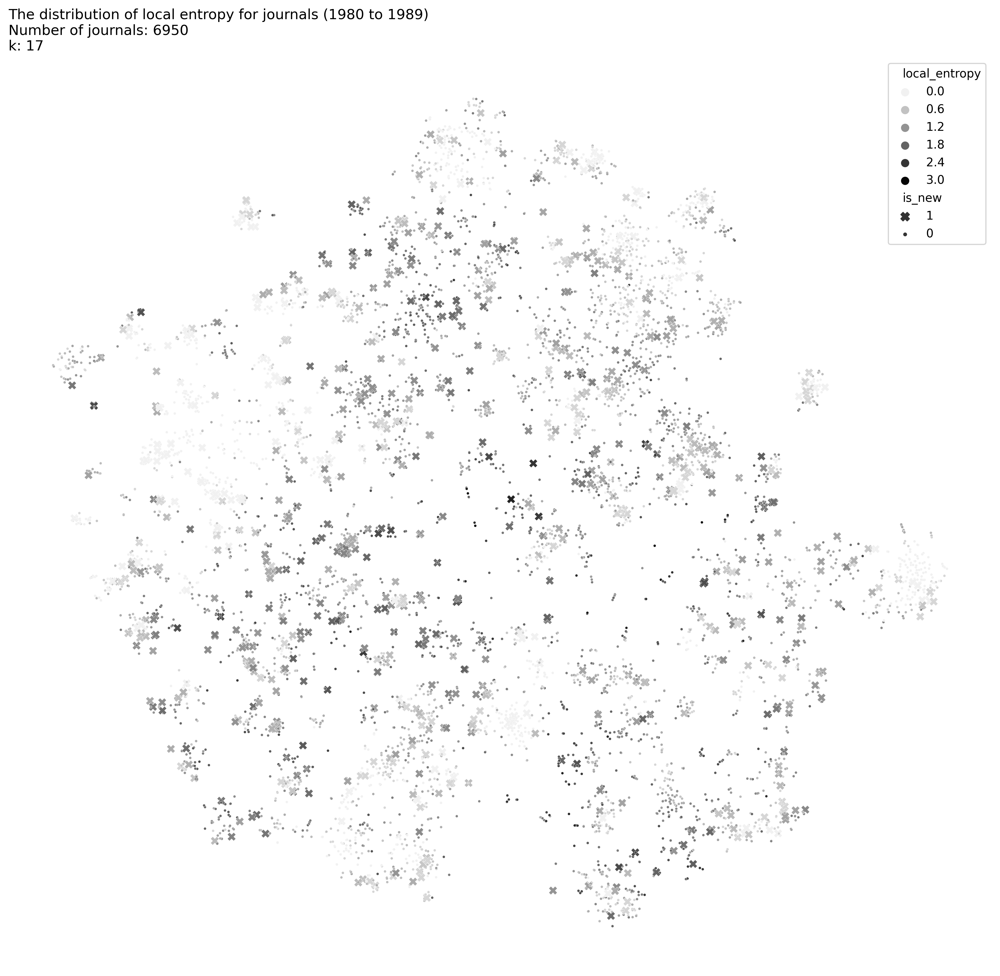

In [157]:
model.plot_local_entropy_map(1980,1989, 100, 10, k=17, 
                      y_flip=False, rotate_90_clockwise=True)

Text(0, 0.5, 'frequency')

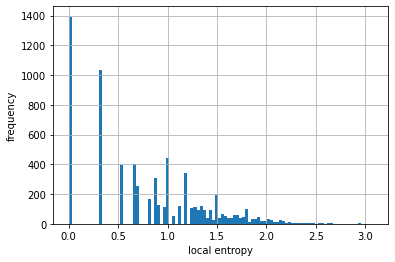

In [191]:
hist = model.knn_df.local_entropy.hist(bins=100)
hist.set_xlabel("local entropy")
hist.set_ylabel("frequency")

In [192]:
model.knn_df.sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
626,100460328,"[-0.14536472, 0.030031357, 0.086442865, 0.0461...",Multidisciplinary,3.077820,Scientific American,1845,0
2497,920941,"[0.19331558, -0.017375883, -0.09712315, -0.192...",Chemical Engineering,3.030639,Color Research and Application,None,0
1639,203291325,"[-0.013844663, 0.15767474, 0.15905477, 0.05477...",Multidisciplinary,2.952820,American Scientist,None,0
5564,73028643,"[0.024505729, 0.11314377, -0.037580606, 0.0088...",Decision Sciences,2.952820,Journal of Classification,None,0
3944,60203362,"[-0.061080284, 0.025307246, 0.19032837, -0.105...",Medicine,2.952820,Journal of Occupational Accidents,None,0
4762,147202451,"[-0.10588061, -0.04439367, 0.13351762, -0.0019...",Environmental Science,2.905639,Conservation & Recycling,None,0
7766,196862746,"[-0.064967446, 0.02512678, 0.033509832, -0.191...",Medicine,2.875000,Biographical Memoirs of Fellows of the Royal S...,None,0
2484,126294776,"[0.2016874, 0.090645604, -0.19700389, 0.140800...",Mathematics,2.780639,Journal of Mathematical Psychology,1964,0
5480,164128033,"[-0.117884904, -0.021374932, 0.081069864, -0.0...",Engineering,2.774397,Science News,None,0
5410,92539022,"[0.15264271, 0.007944587, 0.11879975, -0.12818...",Social Sciences,2.750000,International Journal of Industrial Ergonomics,None,0


In [77]:
model.knn_df[model.knn_df.is_new==1].sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
3239,201595455,"[-0.1493099, 0.12331595, 0.008570214, -0.13780...",Medicine,2.646782,Radiation Protection Dosimetry,1981,1
1941,161248890,"[-0.16123182, 0.03996975, 0.085362375, -0.0597...",Engineering,2.625000,Risk Analysis,1981,1
4743,968878802,"[0.087915525, 0.1765763, 0.05233462, -0.014882...",Materials Science,2.405639,Clothing and Textiles Research Journal,1982,1
3319,32271328,"[-0.08788275, 0.029112935, -0.07517987, -0.190...",Psychology,2.352217,Journal of Environmental Psychology,1980,1
5133,102748110,"[0.32130966, 0.06172992, 0.044610262, 0.010734...",Engineering,2.311278,Complex Systems,1987,1
4538,123979729,"[-0.07357645, -0.027899332, -0.059410963, -0.0...","Biochemistry, Genetics and Molecular Biology",2.298795,Biomedical Chromatography,1986,1
5359,155153587,"[-0.1046402, -0.030584672, 0.06301866, -0.1382...","Economics, Econometrics and Finance",2.280639,Marine Resource Economics,1984,1
4916,123019304,"[0.23191929, 0.0614951, -0.04840491, -0.083669...",Computer Science,2.224602,Neural Networks,1988,1
816,34814058,"[0.04102787, -0.017073216, -0.021236379, -0.03...",Engineering,2.180037,Journal of Biomedical Materials Research,2003,1
1342,163807576,"[0.03835084, -0.045457385, -0.041783895, -0.04...",Engineering,2.180037,Biomaterials,1985,1


In [158]:
center_VID = 102748110

In [159]:
neighbor_index = model.knn.kneighbors(X=model.knn_df[model.knn_df.VID==center_VID].vector.to_list(), n_neighbors=16, return_distance=False)
neighbor_df = model.knn_df.iloc[neighbor_index.reshape(-1,)]
neighbor_df = neighbor_df.drop(neighbor_df[neighbor_df.VID==center_VID].index)

In [160]:
neighbor_df[['VID', 'venue_name', 'year_founded', 'is_new', 'label']]

,VID,venue_name,year_founded,is_new,label
6347,207023548,Neural Computation,1989,1,Neuroscience
8388,159543560,Connection Science,None,0,Computer Science
4916,123019304,Neural Networks,1988,1,Computer Science
663,87357125,Biological Cybernetics,None,0,Medicine
5946,91252481,Computer Speech & Language,None,0,Computer Science
3841,62148650,Machine Learning,1986,1,Computer Science
4215,47092798,IEEE Assp Magazine,None,0,Engineering
7321,117679221,SIAM Journal on Discrete Mathematics,1988,1,Mathematics
649,24688465,Physica D: Nonlinear Phenomena,None,0,Physics and Astronomy
5876,2764355106,Functional differential equations,None,0,Mathematics


2023-08-23 19:39:51 -- start loading VID_labeled...
2023-08-23 19:39:51 -- finish.
2023-08-23 19:39:51 -- start loading wv_2d...
2023-08-23 19:39:51 -- finish.


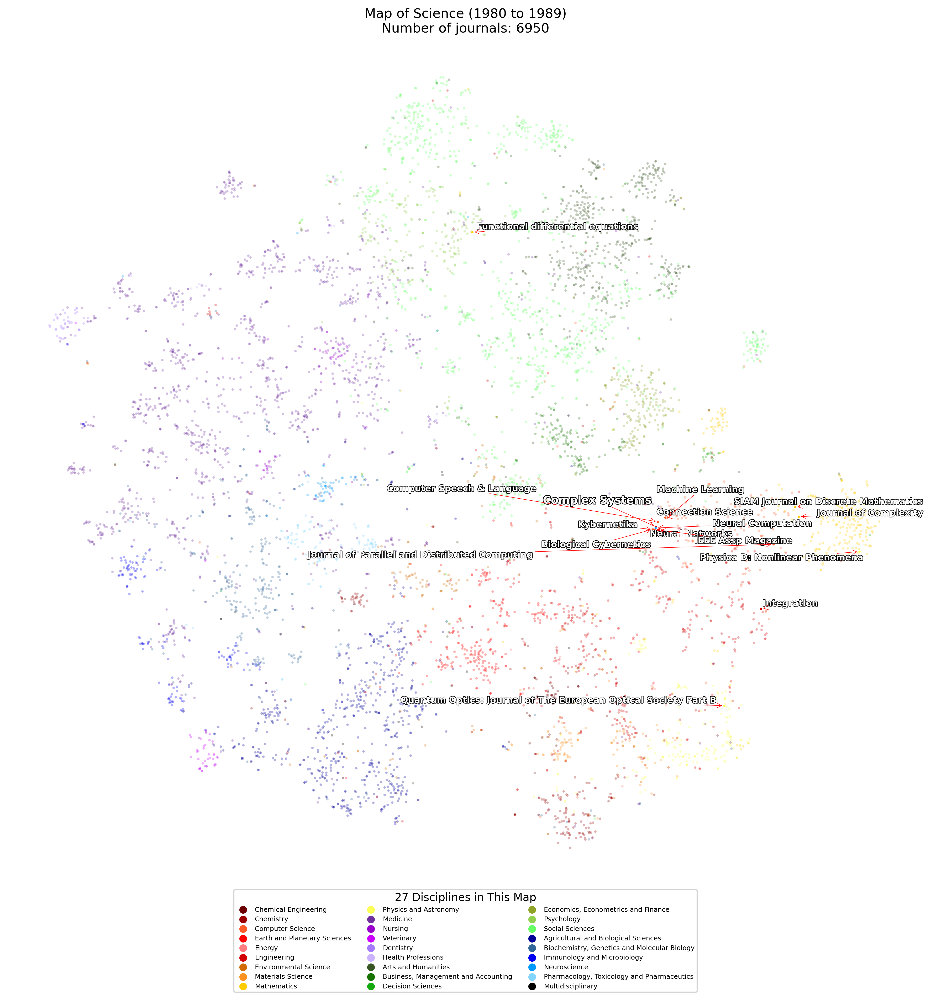

In [161]:
model.plot_map_of_sci(1980,1989, 100, 10,
                      y_flip=False, rotate_90_clockwise=True,
                      annotate=True, center_VID=center_VID, neighbor_VID_list=neighbor_df.VID.to_list())

In [187]:
model.cal_entropy(1990, 1999, 100, 10, k=16)

2023-08-23 20:08:18 -- start loading word vectors...
2023-08-23 20:08:18 -- word vectors loaded, and its shape is: (15153, 100)
2023-08-23 20:08:18 -- start loading VID_labeled...
2023-08-23 20:08:18 -- finish.


2023-08-23 19:41:19 -- start loading wv_2d...
2023-08-23 19:41:19 -- finish.


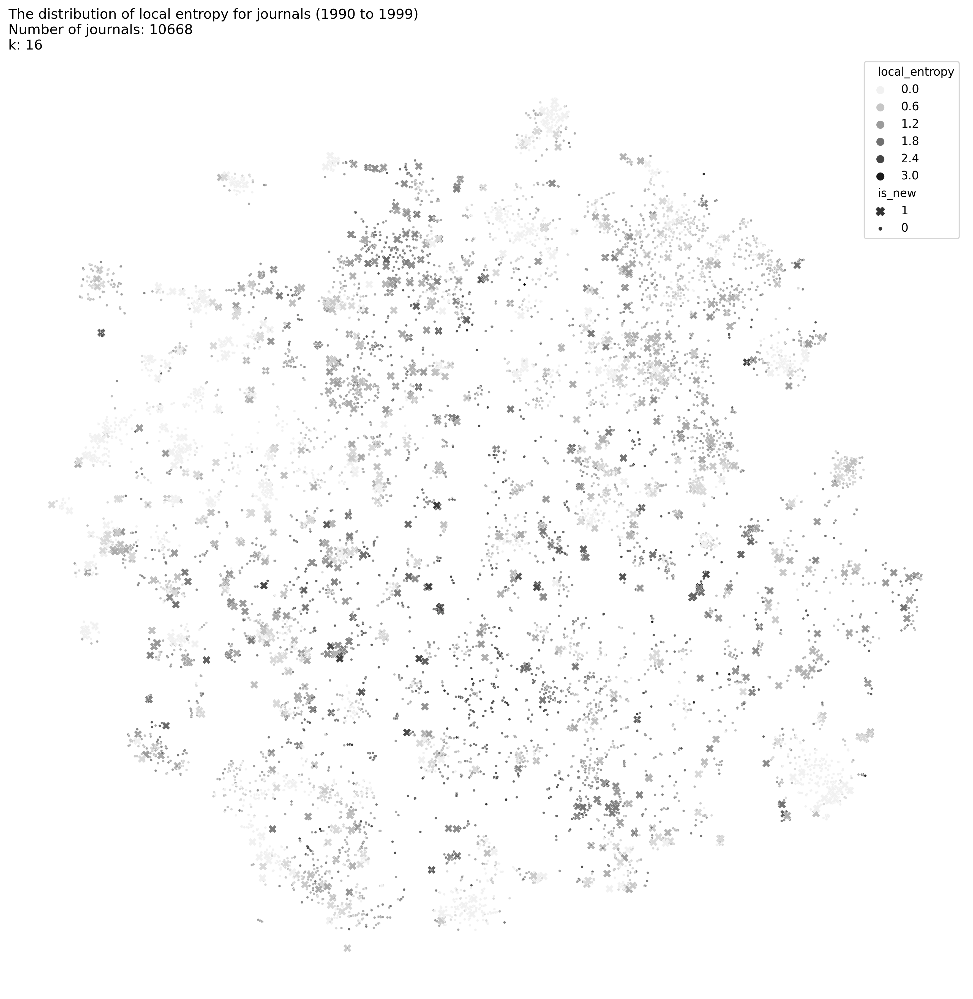

In [163]:
model.plot_local_entropy_map(1990,1999, 100, 10, k=16, 
                             y_flip=True, rotate_90_clockwise=False)

Text(0, 0.5, 'frequency')

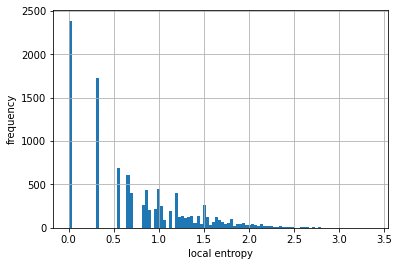

In [188]:
hist = model.knn_df.local_entropy.hist(bins=100)
hist.set_xlabel("local entropy")
hist.set_ylabel("frequency")

In [189]:
model.knn_df.sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
7411,164128033,"[0.102548555, 0.023115972, 0.08351011, -0.0642...",Engineering,3.375000,Science News,None,0
4991,142298166,"[0.00896223, 0.03303721, -0.15879972, -0.05332...",Engineering,3.024397,Journal of Microwave Power and Electromagnetic...,None,0
3531,920941,"[-0.006409211, 0.02260037, -0.044109195, -0.14...",Chemical Engineering,3.000000,Color Research and Application,None,0
12461,1036471906,"[-0.02703361, -0.23193882, -0.31828016, -0.017...",Engineering,2.899397,Revista Ingenieria E Investigacion,None,0
10664,9683234,"[0.026905134, -0.18764304, 0.024154857, 0.1814...",Multidisciplinary,2.858459,Science Progress,1916,0
2131,24602492,"[-0.013323906, -0.18280336, -0.022950422, 0.14...",Medicine,2.780639,Journal of The Korean Surgical Society,None,0
7331,69876307,"[-0.0071787084, -0.12263413, -0.10335207, 0.00...",Social Sciences,2.780639,Resonance,None,0
2755,99347777,"[-0.10010499, -0.14105633, -0.11864971, 0.0695...",Mathematics,2.780639,BioSystems,1967,0
11298,190336160,"[-0.120538294, -0.08458007, -0.17870842, -0.05...",Mathematics,2.774397,"Nonlinear Dynamics, Psychology, and Life Sciences",None,0
1868,86512602,"[0.026793914, -0.19445749, -0.21343619, 0.1589...",Chemical Engineering,2.727217,Desalination,None,0


In [83]:
model.knn_df[model.knn_df.is_new==1].sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
9263,207319443,"[0.010270786, -0.1795332, -0.09542494, -0.0025...",Computer Science,2.727217,Complexity,1995,1
13319,171268996,"[0.0054030106, -0.024577528, -0.06932962, -0.0...",Engineering,2.521782,Annual Review of Biomedical Engineering,1999,1
6448,127318573,"[0.1820359, -0.029783618, 0.0073419316, -0.006...",Arts and Humanities,2.483459,Environmental Values,1992,1
12108,129686714,"[0.08234775, -0.11604508, -0.1062039, -0.04983...","Business, Management and Accounting",2.477217,Journal of Risk Research,1998,1
12000,12267756,"[-0.16758473, 0.021931663, -0.05155039, -0.096...",Medicine,2.477217,Journal of Laboratory Automation,1996,1
3510,51527640,"[0.056459617, -0.00013711562, -0.13856569, -0....",Physics and Astronomy,2.452820,Scanning,1994,1
10484,186646444,"[0.007195867, 0.04337895, 0.0824395, 0.1016194...",Medicine,2.352217,Biological Research,1992,1
3845,123408762,"[0.084285975, -0.0015304019, -0.0017053602, 0....","Biochemistry, Genetics and Molecular Biology",2.352217,Phytochemical Analysis,1991,1
4026,178924077,"[0.27194256, -0.23663262, -0.025607118, 0.1425...",Chemistry,2.352217,Polycyclic Aromatic Compounds,1990,1
9175,39425270,"[0.01664232, 0.009380342, -0.14441103, 0.01770...",Mathematics,2.349602,Journal of Biological Systems,1993,1


In [164]:
center_VID = 207319443

In [165]:
neighbor_index = model.knn.kneighbors(X=model.knn_df[model.knn_df.VID==center_VID].vector.to_list(), n_neighbors=16, return_distance=False)
neighbor_df = model.knn_df.iloc[neighbor_index.reshape(-1,)]
neighbor_df = neighbor_df.drop(neighbor_df[neighbor_df.VID==center_VID].index)

In [166]:
neighbor_df[['VID', 'venue_name', 'year_founded', 'is_new', 'label']]

,VID,venue_name,year_founded,is_new,label
13094,107361000,Advances in Complex Systems,1998,1,Engineering
2755,99347777,BioSystems,1967,0,Mathematics
5531,2181302,Artificial Life,1993,1,Computer Science
6088,183337005,Adaptive Behavior,1992,1,Psychology
14545,142731909,Metascience,None,0,Arts and Humanities
10132,47778307,Computational and Mathematical Organization Th...,1995,1,Computer Science
6545,121026525,Journal of Evolutionary Economics,None,0,"Economics, Econometrics and Finance"
8668,93787993,IEEE Transactions on Evolutionary Computation,1997,1,Computer Science
13317,181493553,Experimental Economics,None,0,"Economics, Econometrics and Finance"
6992,137349598,Journal of Difference Equations and Applications,None,0,Mathematics


2023-08-23 19:41:21 -- start loading VID_labeled...
2023-08-23 19:41:21 -- finish.
2023-08-23 19:41:21 -- start loading wv_2d...
2023-08-23 19:41:21 -- finish.


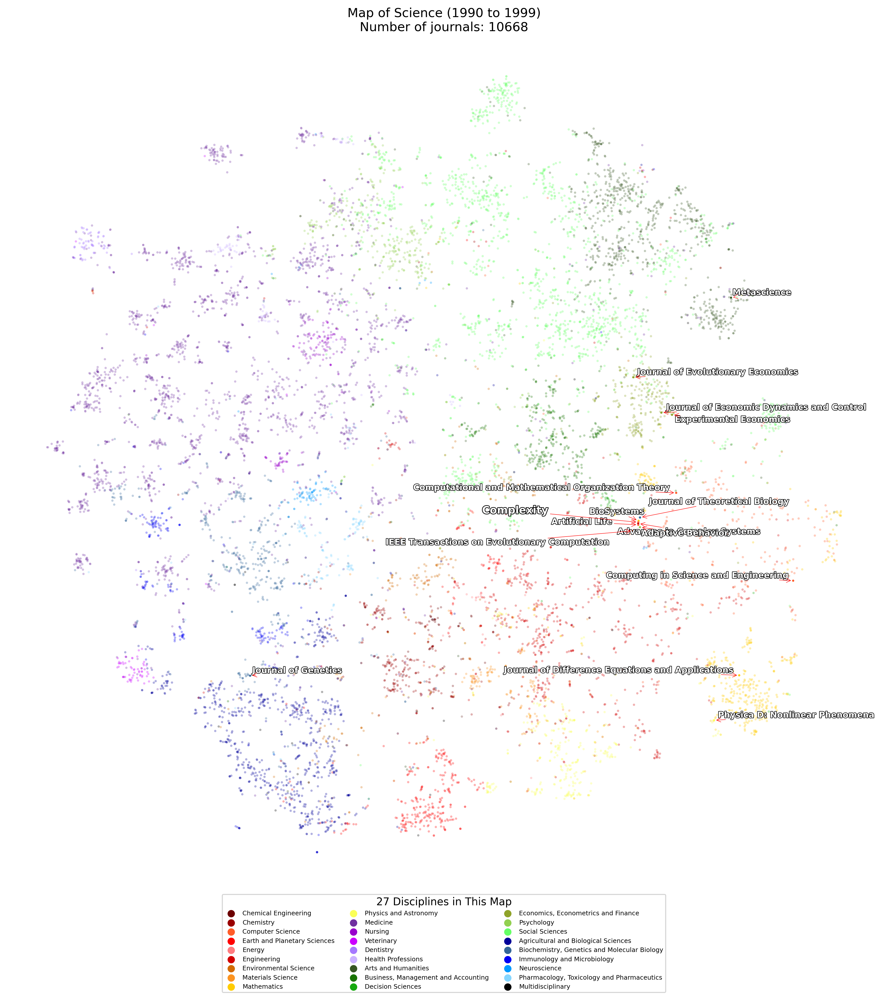

In [167]:
model.plot_map_of_sci(1990,1999, 100, 10,
                      y_flip=True, rotate_90_clockwise=False,
                      annotate=True, center_VID=center_VID, neighbor_VID_list=neighbor_df.VID.to_list())

In [184]:
model.cal_entropy(2000, 2009, 100, 10, k=16)

2023-08-23 20:03:37 -- start loading word vectors...
2023-08-23 20:03:37 -- word vectors loaded, and its shape is: (27604, 100)
2023-08-23 20:03:37 -- start loading VID_labeled...
2023-08-23 20:03:37 -- finish.


2023-08-23 19:44:10 -- start loading wv_2d...
2023-08-23 19:44:10 -- finish.


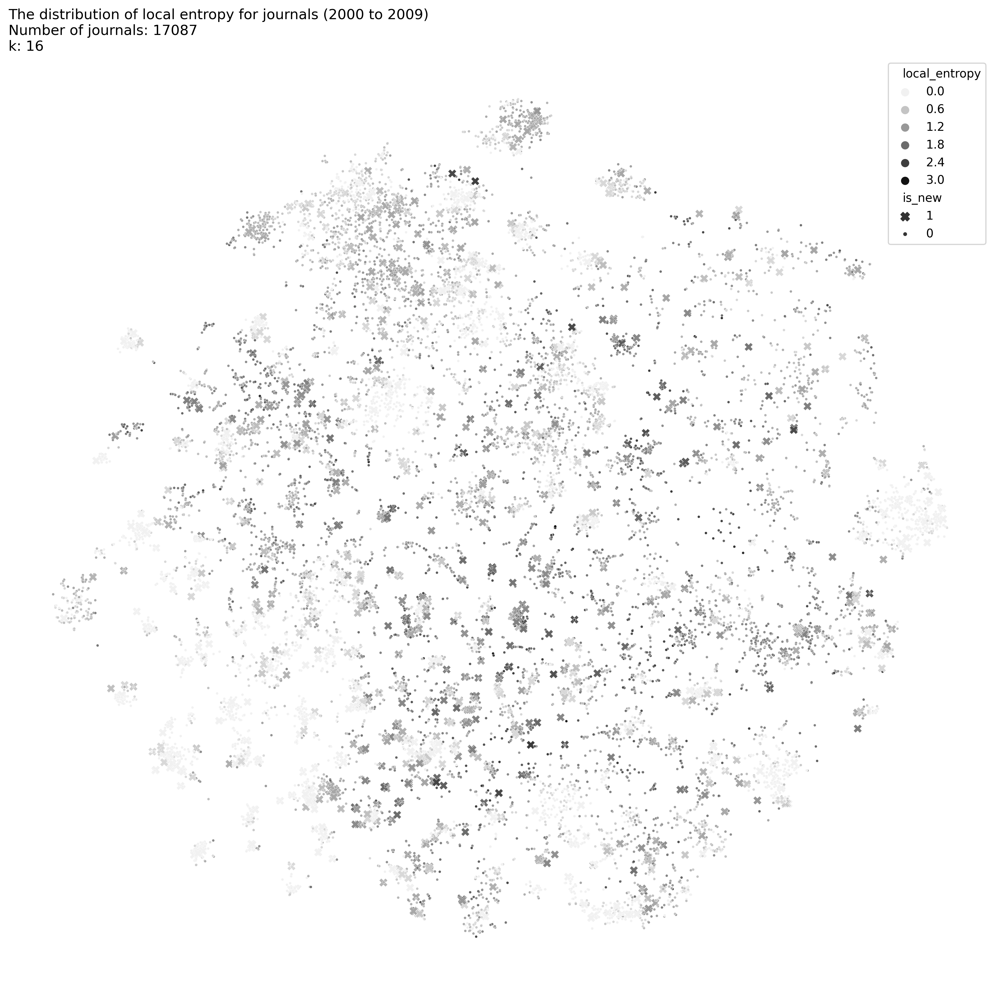

In [171]:
model.plot_local_entropy_map(2000,2009, 100, 10, k=16,
                            y_flip=True, rotate_90_clockwise=False)

Text(0, 0.5, 'frequency')

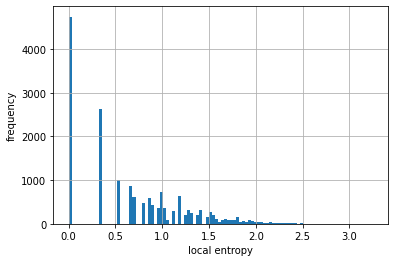

In [185]:
hist = model.knn_df.local_entropy.hist(bins=100)
hist.set_xlabel("local entropy")
hist.set_ylabel("frequency")

In [186]:
model.knn_df.sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
14258,166800597,"[-0.0023919044, -0.007325504, -0.06663544, -0....",Arts and Humanities,3.250000,Risk Decision and Policy,None,0
15281,172113142,"[0.07097706, 0.20916654, -0.060734257, 0.15917...",Energy,2.952820,International Journal of Critical Infrastructures,None,0
3722,920941,"[0.010074699, 0.01031474, -0.16419597, -0.0668...",Chemical Engineering,2.952820,Color Research and Application,None,0
14092,30253980,"[-0.05712462, -0.09179164, -0.07635443, 0.1789...",Physics and Astronomy,2.952820,International Journal of Physical Sciences,None,0
11877,9683234,"[0.05609255, 0.13366485, -0.066484116, -0.0312...",Multidisciplinary,2.858459,Science Progress,1916,0
5623,129686714,"[0.040159877, 0.106033765, -0.089678474, 0.002...",Social Sciences,2.827820,Journal of Risk Research,1998,0
11797,88545351,"[0.0021504527, -0.018090969, -0.14504123, 0.03...","Biochemistry, Genetics and Molecular Biology",2.827820,Journal of Trace Elements in Experimental Medi...,None,0
2495,45954700,"[0.0190706, -0.031139014, -0.22523883, 0.01147...",Medicine,2.827820,Biological Trace Element Research,1979,0
10541,2764658907,"[0.012416478, -0.06412797, -0.1664867, -0.0279...",Medicine,2.827820,Policy and practice in health and safety,None,0
4624,5458151,"[0.0040965835, -0.0031987848, -0.07158237, 0.0...",Chemical Engineering,2.780639,"Combustion, Explosion, and Shock Waves",1965,0


In [89]:
model.knn_df[model.knn_df.is_new==1].sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
11809,83197289,"[-0.043129284, -0.08519528, -0.036158994, 0.02...",Medicine,2.474602,Journal of Ethnobiology and Ethnomedicine,2005,1
12565,94466862,"[0.072537474, -0.20767844, -0.12652044, 0.0573...",Neuroscience,2.396782,Neuroquantology,2003,1
617,202381698,"[-0.012818356, -0.006469299, -0.024330232, 0.0...",Multidisciplinary,2.352217,PLOS ONE,2006,1
1781,116836101,"[-0.051444076, -0.029619206, 0.0831357, -0.137...",Engineering,2.311278,Lab on a Chip,2010,1
21107,9602430,"[0.098988675, 0.090452105, -0.012834941, 0.003...",Agricultural and Biological Sciences,2.311278,Bioscience Horizons,2008,1
21248,35776942,"[0.024261143, -0.011165827, -0.078277744, -0.0...","Biochemistry, Genetics and Molecular Biology",2.280639,Current Trends in Biotechnology and Pharmacy,2007,1
12182,131583313,"[0.1534099, -0.04937927, 0.112361304, 0.081505...",Arts and Humanities,2.271782,Biological Theory,2005,1
20532,2736404288,"[-0.138993, -0.06635751, -0.09823143, -0.04663...","Economics, Econometrics and Finance",2.271782,Decyzje,2004,1
21939,16439242,"[0.020576548, 0.002760229, 0.026581474, 0.1116...",Computer Science,2.227217,Advances in Adaptive Data Analysis,2009,1
19370,153474389,"[-0.077961765, -0.038604453, -0.046931006, 0.0...",Psychology,2.224602,Journal of Cognitive Engineering and Decision ...,2007,1


In [172]:
center_VID = 83197289

In [173]:
neighbor_index = model.knn.kneighbors(X=model.knn_df[model.knn_df.VID==center_VID].vector.to_list(), n_neighbors=16, return_distance=False)
neighbor_df = model.knn_df.iloc[neighbor_index.reshape(-1,)]
neighbor_df = neighbor_df.drop(neighbor_df[neighbor_df.VID==center_VID].index)

In [174]:
neighbor_df[['VID', 'venue_name', 'year_founded', 'is_new', 'label']]

,VID,venue_name,year_founded,is_new,label
15741,2764369649,Ethnobotany Research and Applications,None,0,Agricultural and Biological Sciences
14664,72250933,Journal of Ethnobiology,None,0,Social Sciences
26610,2764455880,Journal of Faculty Pharmacy of Istanbul Univer...,None,0,"Pharmacology, Toxicology and Pharmaceutics"
26729,2764971028,Ethiopian Pharmaceutical Journal,None,0,"Pharmacology, Toxicology and Pharmaceutics"
664,29564236,Journal of Ethnopharmacology,1979,0,"Pharmacology, Toxicology and Pharmaceutics"
5025,176749245,Economic Botany,1947,0,Agricultural and Biological Sciences
11493,157481311,Journal of Medicinal Plants Research,None,0,"Pharmacology, Toxicology and Pharmaceutics"
20200,83520187,Research Journal of Botany,None,0,Agricultural and Biological Sciences
21765,93921930,Banko Janakari,None,0,Environmental Science
22545,33141064,Records of Natural Products,None,0,"Pharmacology, Toxicology and Pharmaceutics"


2023-08-23 19:44:12 -- start loading VID_labeled...
2023-08-23 19:44:12 -- finish.
2023-08-23 19:44:12 -- start loading wv_2d...
2023-08-23 19:44:12 -- finish.


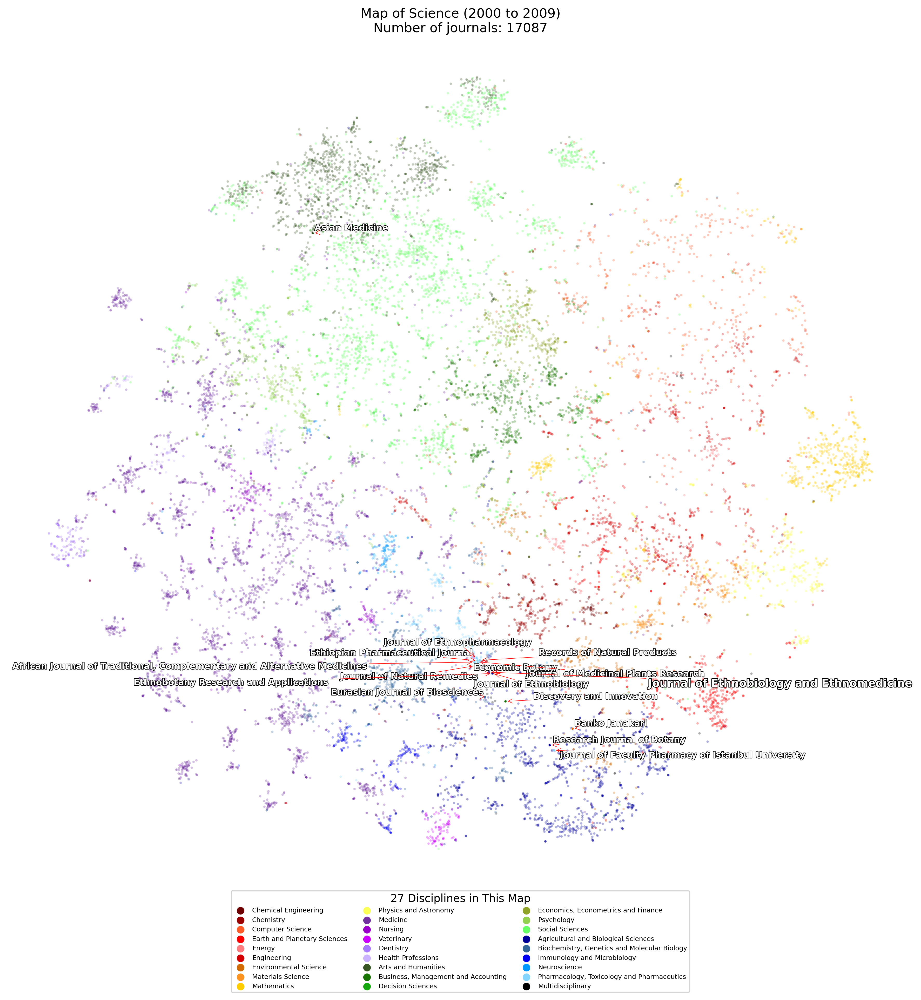

In [175]:
model.plot_map_of_sci(2000,2009, 100, 10,
                      y_flip=True, rotate_90_clockwise=False,
                      annotate=True, center_VID=center_VID, neighbor_VID_list=neighbor_df.VID.to_list())

In [176]:
model.cal_entropy(2010, 2021, 100, 10, k=14)

2023-08-23 19:44:15 -- start loading word vectors...
2023-08-23 19:44:16 -- word vectors loaded, and its shape is: (37679, 100)
2023-08-23 19:44:16 -- start loading VID_labeled...
2023-08-23 19:44:16 -- finish.


2023-08-23 19:47:57 -- start loading wv_2d...
2023-08-23 19:47:57 -- finish.


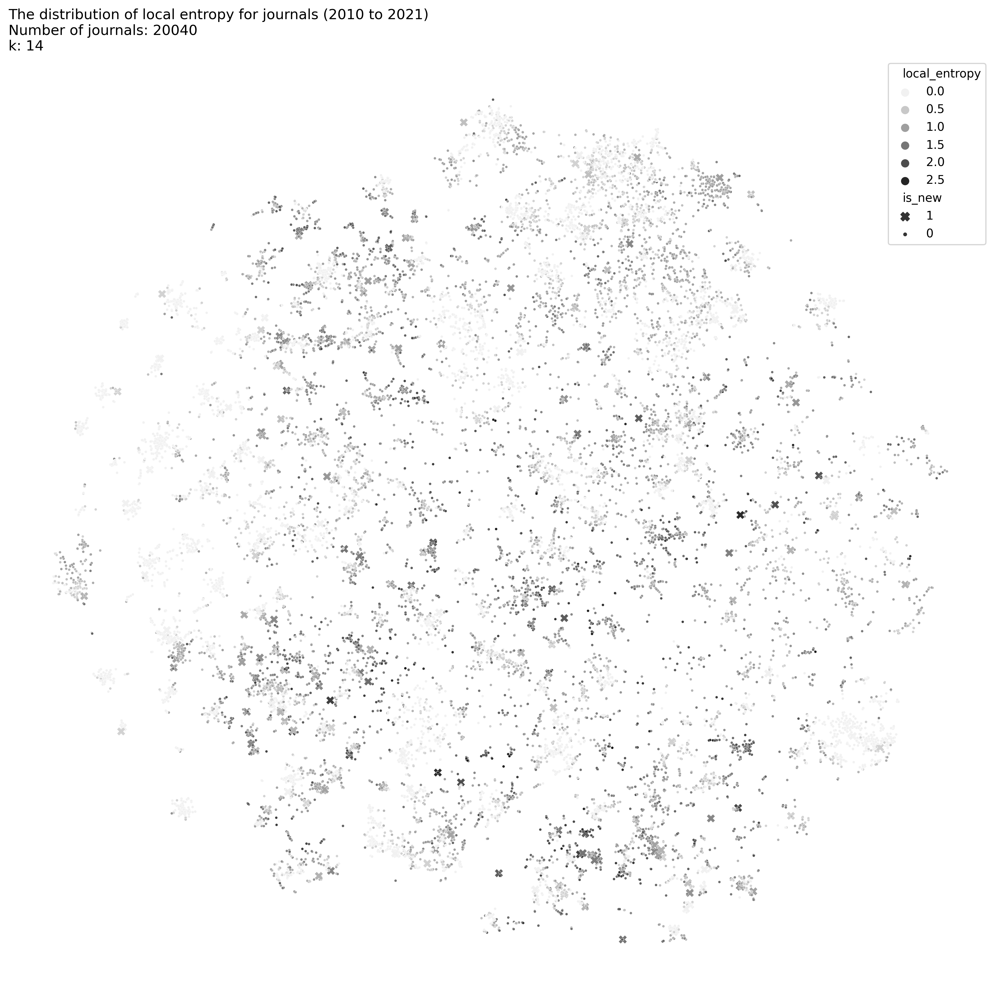

In [177]:
model.plot_local_entropy_map(2010,2021, 100, 10, k=14, 
                             y_flip=True, rotate_90_clockwise=False)

Text(0, 0.5, 'frequency')

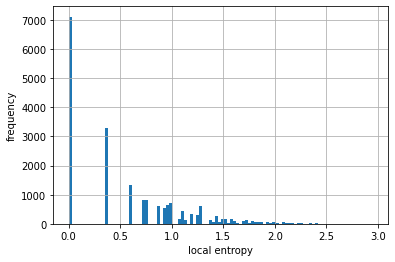

In [183]:
hist = model.knn_df.local_entropy.hist(bins=100)
hist.set_xlabel("local entropy")
hist.set_ylabel("frequency")

In [182]:
model.knn_df.sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
31625,2764414924,"[0.18548037, -0.22707357, 0.052075256, 0.08136...",Environmental Science,2.950212,Ecology and Industry of Russia,None,0
17523,2764484637,"[0.085757025, -0.01891714, 0.07749137, 0.06436...",Mathematics,2.753434,international journal of chemical sciences,None,0
1550,183886180,"[0.12832336, -0.057806738, 0.052236646, 0.0326...",Chemical Engineering,2.753434,Transport in Porous Media,None,0
11102,59886954,"[0.0604426, -0.23458122, 0.1669404, 0.03423939...",Energy,2.753434,Chemical and Petroleum Engineering,None,0
18702,2764999901,"[0.09387406, 0.017240306, -0.040126253, 0.0770...",Immunology and Microbiology,2.753434,Applied Microscopy,None,0
23903,2765000115,"[0.16799407, 0.056456286, -0.022487171, 0.1426...",Agricultural and Biological Sciences,2.753434,Advances in Natural and Applied Sciences,None,0
5649,163784168,"[0.09979482, -0.0038414835, -0.038495246, -0.0...",Multidisciplinary,2.753434,Journal of King Saud University - Science,None,0
12499,84101701,"[0.1286107, -0.11425538, 0.18363248, 0.1976513...","Business, Management and Accounting",2.664498,System Dynamics Review,None,0
5353,57607125,"[-0.045592003, -0.12928593, 0.12205585, -0.006...",Multidisciplinary,2.664498,Journal of Advanced Research,None,0
10921,171495509,"[0.11712014, 0.049153093, 0.042380325, 0.06359...",Chemical Engineering,2.645593,Journal of Chemical Health and Safety,None,0


In [95]:
model.knn_df[model.knn_df.is_new==1].sort_values('local_entropy', ascending=False).head(10)

,VID,vector,label,local_entropy,venue_name,year_founded,is_new
21535,66944380,"[-0.033764407, -0.06729478, -0.16576073, 0.049...","Biochemistry, Genetics and Molecular Biology",2.413800,Journal of Systems Chemistry,2010,1
16046,2764866528,"[-0.07818671, 0.072870664, -0.04477581, 0.0887...",Environmental Science,2.413800,Life sciences in space research,2014,1
2491,2482500137,"[-0.17031138, 0.0007787231, -0.044122566, -0.0...",Medicine,2.182006,Theranostics,2011,1
839,2502047864,"[0.026319027, 0.065740116, 0.044461757, 0.0018...",Chemistry,2.155968,ACS Sustainable Chemistry & Engineering,2013,1
345,116836101,"[-0.0037893432, -0.16631854, 0.084717624, -0.0...",Engineering,2.117963,Lab on a Chip,2010,1
4257,54167817,"[-0.14635615, -0.036351025, -0.13716361, 0.079...",Engineering,2.020244,ACS Synthetic Biology,2012,1
788,1983995261,"[-0.02277782, -0.15639807, -0.090755366, 0.105...","Biochemistry, Genetics and Molecular Biology",1.985228,PeerJ,2013,1
3852,2502055758,"[0.026774148, -0.08413936, -0.03456004, 0.1444...",Agricultural and Biological Sciences,1.985228,Algal Research-Biomass Biofuels and Bioproducts,2012,1
15128,2912241403,"[0.0062244185, 0.012807263, 0.01202366, 0.0011...",Computer Science,1.950212,Nature Machine Intelligence,2019,1
8003,172276550,"[-0.0080117285, -0.15530452, -0.115901716, 0.1...",Computer Science,1.924174,Journal of Biomedical Semantics,2010,1


In [178]:
center_VID = 2764866528

In [179]:
neighbor_index = model.knn.kneighbors(X=model.knn_df[model.knn_df.VID==center_VID].vector.to_list(), n_neighbors=14, return_distance=False)
neighbor_df = model.knn_df.iloc[neighbor_index.reshape(-1,)]
neighbor_df = neighbor_df.drop(neighbor_df[neighbor_df.VID==center_VID].index)

In [180]:
neighbor_df[['VID', 'venue_name', 'year_founded', 'is_new', 'label']]

,VID,venue_name,year_founded,is_new,label
28467,130617652,Biological Sciences in Space,None,0,Medicine
2423,152208300,Radiation Research,1954,0,Medicine
31855,2898345398,REACH,None,0,Engineering
4230,44383424,International Journal of Radiation Biology,1988,0,Medicine
5774,152286864,Radiation and Environmental Biophysics,None,0,Medicine
8114,184795524,Dose-response,2003,0,"Pharmacology, Toxicology and Pharmaceutics"
4810,40303635,Journal of Radiation Research,1960,0,Medicine
14659,2595849600,Frontiers in Astronomy and Space Sciences,None,0,Physics and Astronomy
1142,179591353,Acta Astronautica,1955,0,Engineering
11568,120171627,International Journal of Astrobiology,2002,0,Earth and Planetary Sciences


2023-08-23 19:47:59 -- start loading VID_labeled...
2023-08-23 19:47:59 -- finish.
2023-08-23 19:47:59 -- start loading wv_2d...
2023-08-23 19:47:59 -- finish.


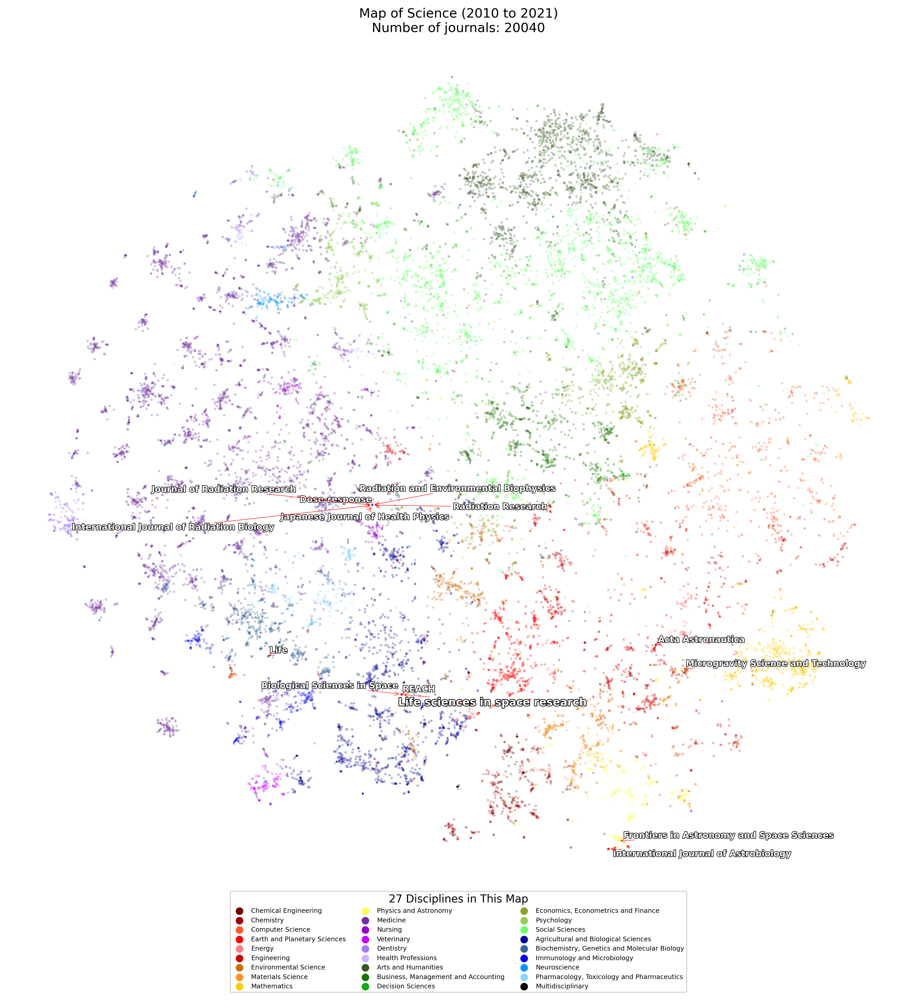

In [181]:
model.plot_map_of_sci(2010,2021, 100, 10,
                      y_flip=True, rotate_90_clockwise=False,
                      annotate=True, center_VID=center_VID, neighbor_VID_list=neighbor_df.VID.to_list())

In [255]:
start_year_list = ['1950', '1960', '1970', '1980', '1990', '2000', '2010']
end_year_list = ['1959', '1969', '1979', '1989', '1999', '2009', '2021']
k_list = [8, 4, 17, 16, 16, 16, 14]

is_df = pd.DataFrame(columns=['VID'])
for i in range(0, 7):
    model.cal_entropy(int(start_year_list[i]), int(end_year_list[i]), 100, 10, k=k_list[i])
    model.knn_df[['interdisciplinary_score_'+start_year_list[i]+'s']] = model.knn_df[['local_entropy']].apply(lambda x: (x-x.min())/(x.max()-x.min()))
    
    tar_is_df = model.knn_df[['VID', 'interdisciplinary_score_'+start_year_list[i]+'s']]
    is_df = is_df.merge(tar_is_df,
                        on=['VID'],
                        how='outer')
is_df.loc[:,'venue_name'] = is_df['VID'].apply(lambda x: model.MAG_venue_info_df.at[x, 'OriginalVenue'])
VID_labele_dict = model.load_VID_labeled(int(start_year_list[i]), int(end_year_list[i]), 100, 10)
is_df['scopus_label'] = is_df.VID.map(lambda x: 
                                          VID_labele_dict['label'][VID_labele_dict['VID'].index(x)] if x in VID_labele_dict['VID']
                                          else np.nan)

2023-08-24 00:58:42 -- start loading word vectors...
2023-08-24 00:58:42 -- word vectors loaded, and its shape is: (1683, 100)
2023-08-24 00:58:42 -- start loading VID_labeled...
2023-08-24 00:58:42 -- finish.
2023-08-24 00:58:45 -- start loading word vectors...
2023-08-24 00:58:45 -- word vectors loaded, and its shape is: (3186, 100)
2023-08-24 00:58:45 -- start loading VID_labeled...
2023-08-24 00:58:45 -- finish.
2023-08-24 00:58:51 -- start loading word vectors...
2023-08-24 00:58:51 -- word vectors loaded, and its shape is: (5761, 100)
2023-08-24 00:58:51 -- start loading VID_labeled...
2023-08-24 00:58:51 -- finish.
2023-08-24 00:59:08 -- start loading word vectors...
2023-08-24 00:59:08 -- word vectors loaded, and its shape is: (9437, 100)
2023-08-24 00:59:08 -- start loading VID_labeled...
2023-08-24 00:59:08 -- finish.
2023-08-24 00:59:43 -- start loading word vectors...
2023-08-24 00:59:43 -- word vectors loaded, and its shape is: (15153, 100)
2023-08-24 00:59:43 -- start loa

In [256]:
is_df['mean_interdisciplinary_score'] = is_df.drop(['VID', 'venue_name', 'scopus_label'], axis = 1).mean(axis=1, numeric_only=True)

In [264]:
is_df.groupby('scopus_label').mean().sort_values('mean_interdisciplinary_score')

/tmp/ipykernel_125403/3496097751.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  is_df.groupby('scopus_label').mean().sort_values('mean_interdisciplinary_score')


,VID,interdisciplinary_score_1950s,interdisciplinary_score_1960s,interdisciplinary_score_1970s,interdisciplinary_score_1980s,interdisciplinary_score_1990s,interdisciplinary_score_2000s,interdisciplinary_score_2010s,mean_interdisciplinary_score
scopus_label,,,,,,,,,
Mathematics,5.745911e+08,0.139450,0.173881,0.164768,0.174229,0.140935,0.113512,0.118374,0.134960
Medicine,8.972488e+08,0.181104,0.190834,0.208203,0.185482,0.151586,0.133539,0.128071,0.139744
Dentistry,8.925249e+08,0.236980,0.000000,0.246137,0.214646,0.167330,0.138908,0.147814,0.166089
Agricultural and Biological Sciences,6.765949e+08,0.250049,0.171973,0.267937,0.186502,0.162477,0.157414,0.139641,0.167747
Arts and Humanities,6.288548e+08,0.206727,0.150701,0.200561,0.178551,0.180842,0.194330,0.158898,0.173342
Earth and Planetary Sciences,5.611155e+08,0.149675,0.160628,0.177233,0.178145,0.144880,0.141945,0.179207,0.176361
Social Sciences,8.108542e+08,0.293962,0.241238,0.230824,0.232849,0.194209,0.196171,0.185464,0.200385
"Business, Management and Accounting",6.581581e+08,0.521761,0.388910,0.400139,0.316656,0.199371,0.220691,0.190053,0.218444
"Economics, Econometrics and Finance",7.691558e+08,0.221137,0.167040,0.215256,0.255871,0.254886,0.203321,0.202532,0.222237


In [259]:
pd.wide_to_long(is_df,
                stubnames=['interdisciplinary_score'],
                suffix='.+',
                sep='_',
                i = ['VID', 'venue_name', 'scopus_label'],
                j = 'decade')

mean_interdisciplinary_score  \
VID       venue_name                  scopus_label        decade                                 
137773608 Nature                      Multidisciplinary   1950s                       0.555349   
                                                          1960s                       0.555349   
                                                          1970s                       0.555349   
                                                          1980s                       0.555349   
                                                          1990s                       0.555349   
...                                                                                        ...   
159663246 Histoire & Sociétés Rurales Arts and Humanities 1970s                       0.254082   
                                                          1980s                       0.254082   
                                                          1990s                       0.254082   
                                                          2000s                       0.254082   
                                                          2010s                       0.254082   

                                                                  interdisciplinary_score  
VID       venue_name                  scopus_label        decade                           
137773608 Nature                      Multidisciplinary   1950s                  0.636364  
                                                          1960s                  0.500000  
                                                          1970s                  0.700683  
                                                          1980s                  0.634481  
                                                          1990s                  0.392433  
...                                                                                   ...  
159663246 Histoire & Sociétés Rurales Arts and Humanities 1970s                       NaN  
                                                          1980s                       NaN  
                                                          1990s                       NaN  
                                                          2000s                       NaN  
                                                          2010s                  0.254082  

[153342 rows x 2 columns]

<Figure size 1800x1200 with 0 Axes>

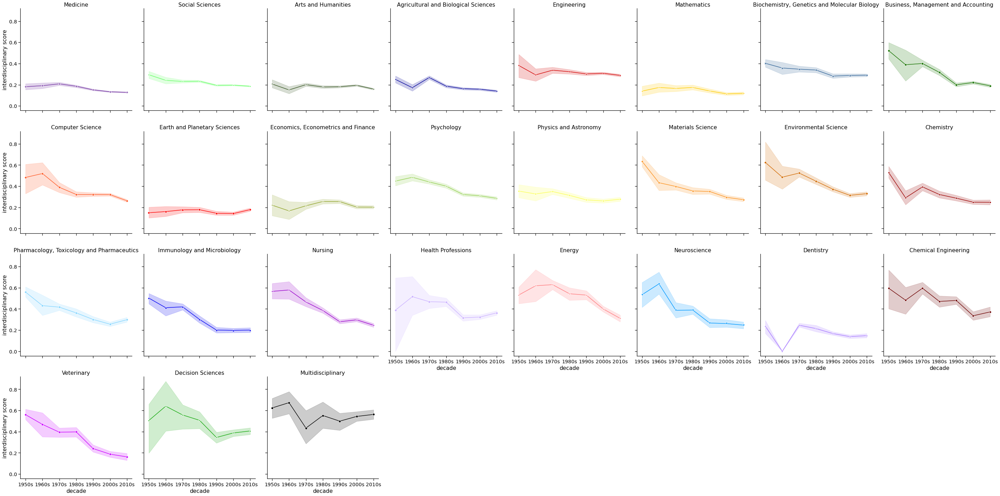

In [262]:
is_df_wide = pd.wide_to_long(is_df,
                             stubnames=['interdisciplinary_score'],
                             suffix='.+',
                             sep='_',
                             i = ['VID', 'venue_name', 'scopus_label'],
                             j = 'decade')

plt.figure(dpi=300)
with sns.plotting_context("notebook", font_scale=1.3):
    ax = sns.relplot(data=is_df_wide,
                     x='decade', y='interdisciplinary_score',
                     markers=True, dashes=False, style='scopus_label', hue='scopus_label', palette=model.discipline2color,
                     legend=False,
                     col='scopus_label', col_wrap=8, 
                     col_order=['Medicine', 'Social Sciences', 'Arts and Humanities',
                                'Agricultural and Biological Sciences', 'Engineering', 'Mathematics',
                                'Biochemistry, Genetics and Molecular Biology',
                                'Business, Management and Accounting', 'Computer Science',
                                'Earth and Planetary Sciences', 'Economics, Econometrics and Finance',
                                'Psychology', 'Physics and Astronomy', 'Materials Science',
                                'Environmental Science', 'Chemistry',
                                'Pharmacology, Toxicology and Pharmaceutics',
                                'Immunology and Microbiology', 'Nursing', 'Health Professions',
                                'Energy', 'Neuroscience', 'Dentistry', 'Chemical Engineering',
                                'Veterinary', 'Decision Sciences', 'Multidisciplinary'],
                     kind='line')
    ax.set_titles("{col_name}")
    ax.set_ylabels('interdisciplinary score')

In [ ]:
dirs = '/media/sdb/p2v/figs/'
if not os.path.exists(dirs):
    os.makedirs(dirs)
ax.savefig('/media/sdb/p2v/figs/28_discipline_interdisciplinarity_change.pdf', 
            dpi = 300, 
            facecolor='white', 
            transparent=False, 
            bbox_inches='tight')

In [265]:
venue_name_list = ['Science',
                   'Nature',
                   'Proceedings of the National Academy of Sciences of the United States of America', 
                   # 'Journal of Biological Chemistry',
                   
                   'The Lancet',
                   'The New England Journal of Medicine',
                   'JAMA',
                   # 'BMJ',
                   
                   'Physical Review Letters', 
                   'The Astrophysical Journal',
                   'Physical Review D'
                   # 'Monthly Notices of the Royal Astronomical Society'
                  ]

In [266]:
is_df[is_df.venue_name.isin(venue_name_list)]

,VID,interdisciplinary_score_1950s,interdisciplinary_score_1960s,interdisciplinary_score_1970s,interdisciplinary_score_1980s,interdisciplinary_score_1990s,interdisciplinary_score_2000s,interdisciplinary_score_2010s,venue_name,scopus_label,mean_interdisciplinary_score
0,137773608,0.636364,0.50,0.700683,0.634481,0.392433,0.489821,0.533662,Nature,Multidisciplinary,0.555349
6,49861241,0.197660,0.00,0.000000,0.109587,0.198093,0.000000,0.000000,The Lancet,Medicine,0.072191
7,3880285,0.818182,0.75,0.857084,0.774203,0.481960,0.660548,0.612619,Science,Multidisciplinary,0.707799
8,172573765,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,JAMA,Medicine,0.000000
19,62468778,0.000000,0.00,0.000000,0.000000,0.099938,0.000000,0.000000,The New England Journal of Medicine,Medicine,0.014277
64,125754415,0.563198,0.75,0.253388,0.217220,0.099938,0.345120,0.621057,Proceedings of the National Academy of Science...,Multidisciplinary,0.407132
352,1980519,0.295010,0.00,0.204173,0.263589,0.099938,0.000000,0.000000,The Astrophysical Journal,Physics and Astronomy,0.123244
696,133490392,0.000000,0.00,0.098020,0.109587,0.099938,0.000000,0.000000,Physical Review D,Physics and Astronomy,0.043935
711,24807848,0.385919,0.00,0.098020,0.000000,0.099938,0.000000,0.000000,Physical Review Letters,Physics and Astronomy,0.083411


In [269]:
tar_is_df_wide = pd.wide_to_long(is_df[is_df.venue_name.isin(venue_name_list)],
                             stubnames=['interdisciplinary_score'],
                             suffix='.+',
                             sep='_',
                             i = ['VID', 'venue_name', 'scopus_label'],
                             j = 'decade')

In [271]:
tar_is_df_wide

mean_interdisciplinary_score  \
VID       venue_name              scopus_label          decade                                 
137773608 Nature                  Multidisciplinary     1950s                       0.555349   
                                                        1960s                       0.555349   
                                                        1970s                       0.555349   
                                                        1980s                       0.555349   
                                                        1990s                       0.555349   
...                                                                                      ...   
24807848  Physical Review Letters Physics and Astronomy 1970s                       0.083411   
                                                        1980s                       0.083411   
                                                        1990s                       0.083411   
                                                        2000s                       0.083411   
                                                        2010s                       0.083411   

                                                                interdisciplinary_score  
VID       venue_name              scopus_label          decade                           
137773608 Nature                  Multidisciplinary     1950s                  0.636364  
                                                        1960s                  0.500000  
                                                        1970s                  0.700683  
                                                        1980s                  0.634481  
                                                        1990s                  0.392433  
...                                                                                 ...  
24807848  Physical Review Letters Physics and Astronomy 1970s                  0.098020  
                                                        1980s                  0.000000  
                                                        1990s                  0.099938  
                                                        2000s                  0.000000  
                                                        2010s                  0.000000  

[63 rows x 2 columns]

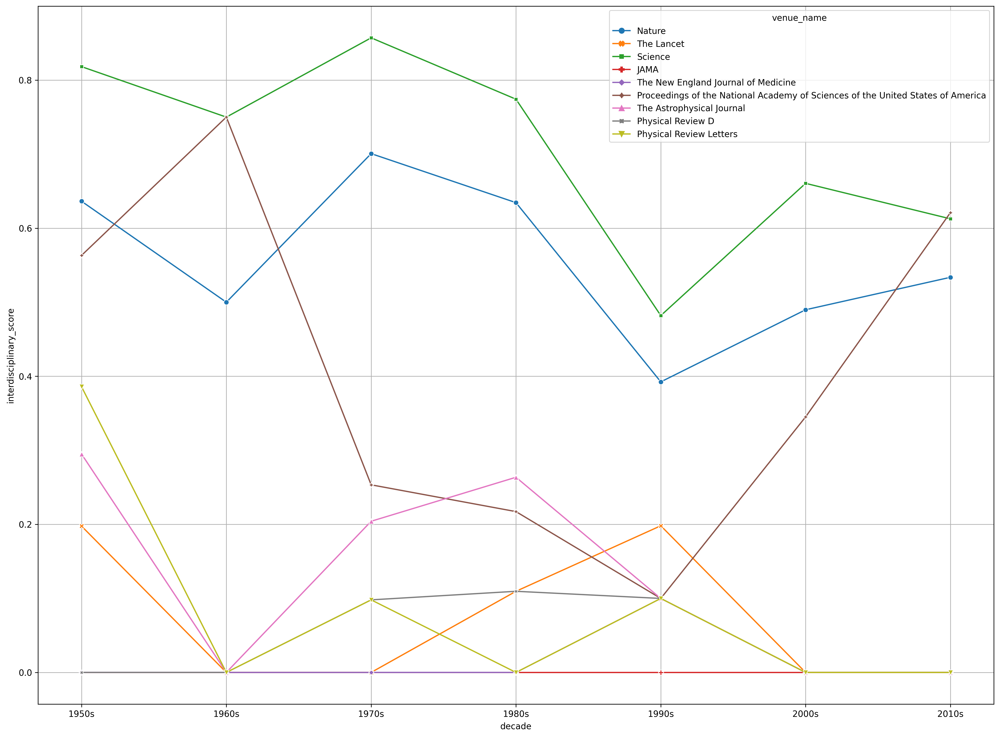

In [301]:
fig = plt.figure(figsize=(20, 15), dpi=300)
sns.lineplot(tar_is_df_wide, x='decade', y='interdisciplinary_score', 
             hue='venue_name', style='venue_name', markers=True, dashes=False,)
plt.grid()
plt.show()